## Data Exploration 

### Imports and Working Directory

Change the working directory to the directory containing the dataset.

In [1]:
import os
import json
import random
import numpy as np
import pandas as pd
import open3d as o3d
import seaborn as sns
import matplotlib.pyplot as plt

from typing import Dict, Set, Union, List
from collections import Counter
from pathlib import Path
%config InlineBackend.figure_format = 'svg'

print(f'Current Working Directory: {Path.cwd()}')
target_dir = Path('/srv/healthcare/datascience/data/part-net')
if Path.cwd() != target_dir:
    print('Changing directory')
    os.chdir(target_dir)
    print(f'New Working directory: {Path.cwd()}')
root = Path.cwd()


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.
Current Working Directory: /home/toy-problem/notebooks
Changing directory
New Working directory: /srv/healthcare/datascience/data/part-net


### Available Datasets

We are interested in single class datasets, therefore look at which are available. You can create new ones with `create_singe_class_dataset.IPYNB`

In [5]:
classes = [c for c in os.listdir(root) if not c.startswith('data_v')]
print(f'available single class datasets: {classes}')

available single class datasets: ['data_knife', 'data_table', 'data_lamp', 'data_tbl', 'data_table_original', 'data_scissors']


### Select Dataset

Change the ```dataset``` variable in the code below to the class you want to visualise samples of

In [2]:
dataset = 'data_table_original' 

### Plot Part Distribution

Each model is made up of parts, check the distribution of the unique parts for the selected dataset. 

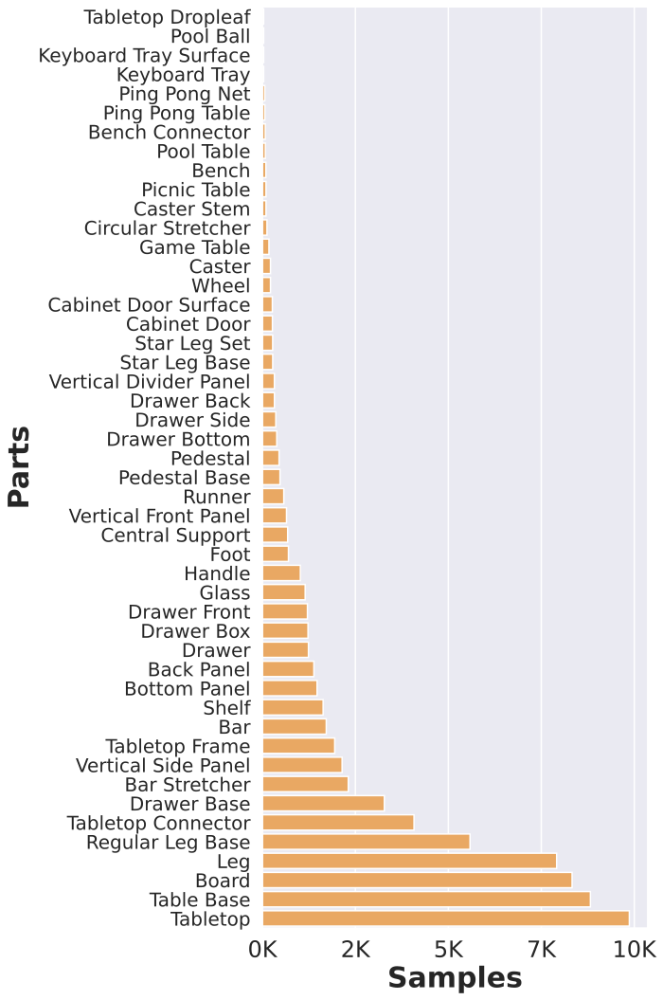

In [5]:
import matplotlib.ticker as ticker

def preprocess_label(label: str) -> str:
    """
    Convert a label to a more readable format.
    Replaces underscores with spaces and capitalizes each word.

    :param label: The original label.
    :return: The formatted label.
    """
    return ' '.join(word.capitalize() for word in label.split('_'))

def filter_classes(data: pd.DataFrame, classes_to_ignore: List[str]) -> pd.DataFrame:
    """
    Filter out the specified classes from the data.

    :param data: DataFrame containing the parts and samples information.
    :param classes_to_ignore: List of class names to ignore.
    :return: Filtered DataFrame.
    """
    return data[~data['parts'].isin(classes_to_ignore)]

def plot_part_distribution(data: pd.DataFrame):
    """
    Plot the part distribution in a visually appealing way.

    :param data: DataFrame containing the parts and samples information.
    """
    # Filter out unwanted classes
    classes_to_ignore = ["table", "table_surface", "regular_table", "tabletop_surface"]
    data = filter_classes(data, classes_to_ignore)
    
    # Preprocess the labels
    data['parts'] = data['parts'].apply(preprocess_label)

    # Set the size of the figure
    plt.figure(figsize=(10, 15), dpi=300)
    sns.set(style='whitegrid', rc={'axes.facecolor':'#EAEAF2', 
                               'grid.color':'#FFFFFF', 
                               'axes.edgecolor':'#FFFFFF', 
                               'grid.linewidth': 2.5})  # Increase grid line width
    sns.set_context("talk")

    ax = sns.barplot(x='samples', y='parts', data=data, color="#ffa94d")
    ax.set_xlabel('Samples', fontsize=30, weight='bold')
    ax.set_ylabel('Parts', fontsize=30, weight='bold')
    ax.tick_params(axis='x', labelsize=24)
    ax.tick_params(axis='y', labelsize=24)

    # Format x-axis labels to be more readable
    ax.xaxis.set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'{int(x/1000)}K'))

    # Increase space between y-tick labels
    plt.yticks(fontsize=20)
    # ax.set_yticks(ax.get_yticks()[::2])  # Increase space by showing every second tick

    for spine in ax.spines.values():
        spine.set_visible(True)
        # spine.set_color('black')
        spine.set_linewidth(1.5)

    # plt.grid(True, which='both', linestyle='--', linewidth=0.5, color='grey')
    plt.tight_layout()

    # Save the plot before showing it
    plt.savefig("/../../../../../home/toy-problem/notebooks/img/table_part_dist.png")
    
    # Show the plot
    plt.show()

def collect_unique_names(root_dir: Path, subclass: str = None) -> Dict[str, Dict[str, Union[int, Set[str]]]]:
    part_count = Counter()
    
    def add_part(part: str):
        part_count[part] += 1

    def extract_names(data: List[Dict], seen: Set[str] = None) -> Set[str]:
        if seen is None:
            seen = set()
        for item in data:
            if 'name' in item:
                seen.add(item['name'])
            if 'children' in item:
                seen.update(extract_names(item['children'], seen))
        return seen

    result = {}
    for sample_folder in root_dir.iterdir():
        sample_path = root_dir / sample_folder
        if sample_path.is_dir():
            json_path = sample_path / 'result_after_merging.json'
            if json_path.exists():
                with open(json_path, 'r') as file:
                    data = json.load(file)
                    if subclass != None:
                        if data[0]['children'][0]['name'] == subclass:
                            unique_names = extract_names(data)
                    else:
                        unique_names = extract_names(data)
                    for name in unique_names:
                        add_part(name)
                    result[sample_folder] = {
                        'count': len(unique_names),
                        'unique_names': unique_names
                    }

    return result, dict(part_count)

# dataset = "data_table_original"  # Replace with dataset name
subclass = None #'regular_table' # some classes contain unusual subclasses, such as pool_table, ping_pong_table
dataset_root = root / dataset
unique_names_data, part_count = collect_unique_names(dataset_root, subclass)
df = pd.DataFrame(list(part_count.items()), columns=['parts', 'samples'])

plot_part_distribution(df.sort_values('samples'))


### Visualise Single Sample

Visualise the first sample of the selected dataset. The data is a pointcloud, we visualise it using open3d.

In [1]:

def visualise_sample(path: Path) -> None:
    # read point cloud
    if path.exists():
        pcd = o3d.io.read_point_cloud(str(path))
        print(f'Points: {len(pcd.points)}')

        # for some reason the point cloud is always rotated 90 degrees clockwise along the z-axis.
        R = pcd.get_rotation_matrix_from_xyz((np.pi / 2, 0, 0))
        pcd.rotate(R, center=pcd.get_center())
        o3d.visualization.draw_plotly([pcd])

    else: 
        print(f'path does not exist: {path}')

samples = [item.name for item in dataset_root.iterdir() if item.is_dir()]
print(f'There are {len(samples)} samples in the {dataset} folder.')

# load a random sample
sample_path_labels =  dataset_root / samples[0] / 'point_sample' / 'sample-points-all-pts-label-10000.ply'
print('Visualising single sample using open3d:')
visualise_sample(path=sample_path_labels)


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


#### Visualise More Samples

Visualise a couple more samples, 5 in this case.

In [12]:
sample_ids = random.sample(samples, 5)

for sample_id in sample_ids:
    sample_path =  dataset_root / sample_id / 'point_sample' / 'sample-points-all-pts-label-10000.ply'
    visualise_sample(path=sample_path)


Points: 10000


Points: 10000


Points: 10000


Points: 10000


Points: 10000


### Visualise all objects of a given sample

It could be that these files are already removed from the single class dataset. This is because they are of no importance to this project.

In [43]:

def visualise_objects(path: Path) -> None:
    # read point mesh (obj)
    if path.exists():
        for d in path.iterdirs:
            print(d.split('.')[0])
            sample_path = os.path.join(path, d)
            mesh = o3d.io.read_triangle_mesh(sample_path)
            o3d.visualization.draw_plotly([mesh])

    else: 
        print(f'path does not exist: {path}')

samples = os.listdir(dataset)
print(f'There are {len(samples)} samples in the {dataset} folder.')

# load a random sample
sample_path_labels =  os.path.join(os.getcwd(), dataset, samples[0], 'objs-normalized-as-shapenetv1')
print('Visualising single sample using open3d:')
visualise_objects(path=sample_path_labels)

There are 9906 samples in the data_table folder.
Visualising single sample using open3d:
path does not exist: /srv/healthcare/datascience/data/part-net/data_table/33651/objs-normalized-as-shapenetv1


### Label Analysis

Examining the `point_sample/` folder reveals multiple files presumed to contain labels. As per the PartNet repository, `sample-points-all-label-10000.txt` associates each point in the cloud with a label. Given the existence of superclasses (or, more accurately, super parts), it's evident that some parts may belong to multiple classes—e.g., a point might be categorized as "table", "table_base", and "leg". The ambiguity arises in how such classifications are handled during labeling.

Note: The accurate labels are confined to `results.json`, contrary to `result_after_merging.json`.

Upon visualizing a point cloud, where color differentiation is based on the labels in `results.json`, we aim to understand the labeling mechanism more clearly.

In [14]:
counter = Counter()

def visualise_colored_sample(path: Path, cmap, labels) -> None:
    # read point cloud
    if path.exists():
        pcd = o3d.io.read_point_cloud(str(path))
        pcd_colors = np.array([cmap[label] for label in labels])
        pcd.colors = o3d.utility.Vector3dVector(pcd_colors)
        # for some reason the point cloud is always rotated 90 degrees clockwise along the z-axis.
        R = pcd.get_rotation_matrix_from_xyz((np.pi / 2, 0, 0))
        pcd.rotate(R, center=pcd.get_center())
        o3d.visualization.draw_plotly([pcd])

    else: 
        print(f'path does not exist: {path}')

def count_unique_labels(file: Path):
    labels = []
    with file.open('r') as f:
        lines = f.readlines()
        for line in lines:
            label = line.strip()
            counter[label] +=1 
            labels.append(label)
    return set(counter.keys()), labels

def sample_colors_from_colormap(num_colors: int, cmap_name: str = 'tab10') -> list:
    cmap = plt.get_cmap(cmap_name)
    indices = np.linspace(0, cmap.N - 1, num_colors, dtype=int)  # Get evenly spaced indices
    colors = [cmap(idx)[:3] for idx in indices]  # Get the RGB values
    colors_8bit = [tuple(int(c * 255) for c in color) for color in colors]  # Convert to 8-bit RGB values
    return colors_8bit

# Assuming dataset and dataset_root are defined, and dataset_root is a Path object
dirs = next(dataset_root.iterdir())
first_file = dataset_root / dirs / 'point_sample' / 'sample-points-all-label-10000.txt'

unique_labels, labels = count_unique_labels(first_file)
colors = sample_colors_from_colormap(len(unique_labels))
label_cmap = {label: color for label, color in zip(unique_labels, colors)}
pcd_file = dataset_root / dirs / 'point_sample' / 'sample-points-all-pts-label-10000.ply'

visualise_colored_sample(pcd_file, label_cmap, labels)

In [47]:
def plot_sample_dist(data: pd.DataFrame):
    """
    Plot the class distribution in a visually appealing way, with improved readability for the labels
    and large numbers on the x-axis.

    :param data: DataFrame containing the class and samples information.
    """
    data['parts'] = data['parts'].str.replace('_', ' ').str.capitalize()
    plt.figure(figsize=(10, 12), dpi=1000)  # Adjusted figure size for better visibility
    ax = sns.barplot(y='parts', x='samples', data=data, palette='viridis')
    ax.set_title('Point (Part) Label Distribution', fontsize=20)
    ax.set_xlabel('Samples', fontsize=18)
    ax.set_ylabel('Label', fontsize=18)
    plt.xticks(fontsize=14, rotation=45, ha='right')  # Rotate x-axis labels for clarity
    plt.yticks(fontsize=14)
    plt.grid(True, which='both', linestyle='--', linewidth=0.5)

    # Format the x-axis tick labels to use scientific notation
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.0e}'))
    # ax.set_xscale('log')
    
    plt.tight_layout()
    plt.subplots_adjust(right=0.80)  # May adjust depending on the final layout
    plt.savefig("/../../../../../home/toy-problem/notebooks/img/table_part_dist.png")  # Ensure to use a valid and accessible path


### Visualizing Label Distribution Based on txt File Labels

In the txt file named `sample-points-all-label-10000.txt`, we've got some basic labels. They don't cover all the parts shown in the distribution we plotted earlier in this notebook. Let's dive into the actual distribution of these labels to get a better picture.

{'other_leaf': 1448064, 'leg': 13931496, 'board': 46158233, 'tabletop_connector': 6104008, 'bar': 4216661, 'bar_stretcher': 2288359, 'runner': 583411, 'shelf': 4155536, 'glass': 5615941, 'pedestal': 1007303, 'central_support': 936204, 'handle': 32615, 'vertical_side_panel': 4883172, 'base_side_panel': 92954, 'back_panel': 1790859, 'drawer_front': 692465, 'bottom_panel': 2301077, 'cabinet_door_surface': 190591, 'circle': 311624, 'foot': 199506, 'vertical_front_panel': 496586, 'book': 8100, 'vertical_divider_panel': 317714, 'wheel': 37840, 'bench_connector': 59391, 'bench': 332424, 'drawer_side': 192154, 'drawer_back': 86055, 'drawer_bottom': 324738, 'drawer_rails': 13399, 'circular_stretcher': 80913, 'caster_mounting_plate': 4585, 'keyboard_tray_rails': 2525, 'keyboard_tray_slider': 207, 'keyboard_tray_surface': 51575, 'top_panel': 56317, 'caster_stem': 8041, 'caster_yoke': 4569, 'brake': 1693, 'drawer_slider': 2066, 'ping_pong_net': 25745, 'ping_pong_paddle': 1223, 'hinge': 134, 'pool_

/tmp/ipykernel_182695/2690152171.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(y='parts', x='samples', data=data, palette='viridis')


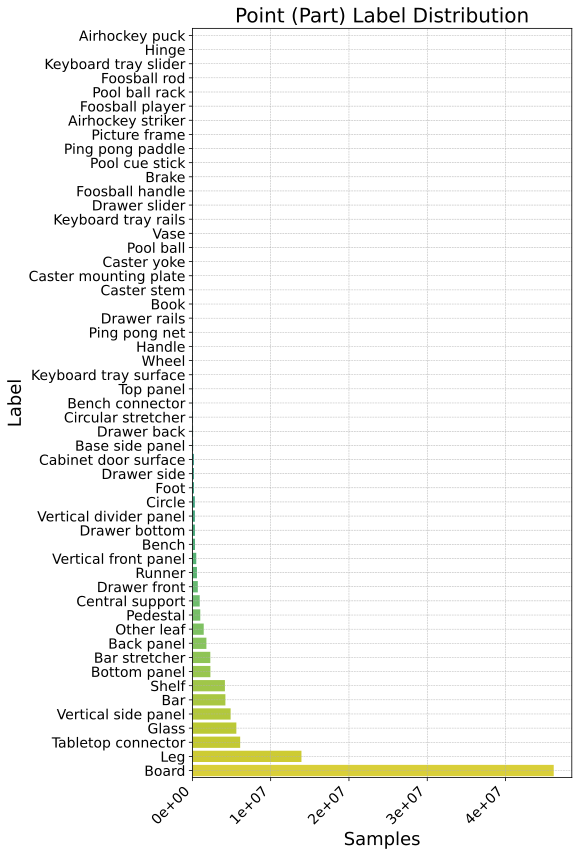

In [48]:
import json
from collections import Counter
from pathlib import Path
    
label_counts = {}

def find_name(data, target_id):
    if isinstance(data, dict):
        if data.get('id') == target_id:
            return data.get('name')
        for key, value in data.items():
            if isinstance(value, (dict, list)):
                name = find_name(value, target_id)
                if name is not None:
                    return name
    elif isinstance(data, list):
        for item in data:
            name = find_name(item, target_id)
            if name is not None:
                return name

def count_labels_in_txt_file(txt_file: Path):
    label_counter = Counter()
    with txt_file.open('r') as f:
        lines = f.readlines()
        for line in lines:
            label = line.strip()
            label_counter[label] += 1
    return label_counter

def add_label_names_to_label_counter(json_file: Path, label_counter: Counter):
    with json_file.open('r') as f:
        data = json.load(f)
        for key, value in label_counter.items():
            key_int = int(key)  # Convert key to integer for comparison
            label = find_name(data, key_int)
            # if label is not None:
            if label in label_counts.keys():
                label_counts[label] += value
            else:
                label_counts[label] = value
        if sum(label_counts.values()) % 10000 != 0:
            raise ValueError("The sum of the label count is not 10000 or a multiple of 10000")
        else:
            return label_counts

# Assuming dataset_root is a Path object
for sample in dataset_root.iterdir():
    txt_file = dataset_root / sample / 'point_sample' / 'sample-points-all-label-10000.txt'
    labels_in_txt = count_labels_in_txt_file(txt_file)
    json_file = dataset_root / sample / 'result.json'
    add_label_names_to_label_counter(json_file, labels_in_txt)
print(label_counts)
df = pd.DataFrame(list(label_counts.items()), columns=['parts', 'samples'])

plot_sample_dist(df.sort_values('samples'))

### Label Conclusions

It turns out that the txt file contains labels for the most basic parts that are found in the results.json file. Each point has exactly one label. The ply files also contain colors that are based on these basic parts, i.e., plotting the base ply file gives the same part segmentation as coloring them based on the labels in the txt file.

One of the ply files also contains normals, which can be useful for the MAE. 

### Visualise Unique Labels in unique_labels.csv
As the integer labels are not conistent across samples, (since PartNet is hyrachical and each part has to be unique), we created unique labels that are consistent across samples, and treat all same parts as the same. 

In [9]:
from typing import Dict, List
import pandas as pd
import numpy as np
import open3d as o3d
import matplotlib.pyplot as plt
from pathlib import Path

def read_labels_from_csv(csv_path: Path) -> List[int]:
    """
    Read integer labels from a CSV file.

    :param csv_path: Path to the CSV file.
    :return: List of integer labels.
    """
    df = pd.read_csv(csv_path)
    return df['Integer Label'].tolist()

def visualise_colored_sample(path: Path, cmap: Dict[int, tuple], labels: List[int]) -> None:
    """
    Visualize a colored sample from a point cloud.

    :param path: Path to the point cloud file.
    :param cmap: Color map for coloring the points.
    :param labels: Labels for each point in the point cloud.
    """
    if path.exists():
        pcd = o3d.io.read_point_cloud(str(path))
        pcd_colors = np.array([cmap[label] for label in labels])
        pcd.colors = o3d.utility.Vector3dVector(pcd_colors)
        R = pcd.get_rotation_matrix_from_xyz((np.pi / 2, 0, 0))
        pcd.rotate(R, center=pcd.get_center())
        o3d.visualization.draw_plotly([pcd])
    else: 
        print(f'Path does not exist: {path}')

def sample_colors_from_colormap(num_colors: int, cmap_name: str = 'tab10') -> List[tuple]:
    """
    Sample colors from a colormap.

    :param num_colors: Number of colors to sample.
    :param cmap_name: Name of the matplotlib colormap.
    :return: List of colors.
    """
    cmap = plt.get_cmap(cmap_name)
    indices = np.linspace(0, cmap.N - 1, num_colors, dtype=int)
    colors = [cmap(idx)[:3] for idx in indices]
    colors_8bit = [tuple(int(c * 255) for c in color) for color in colors]
    return colors_8bit

def plot_samples(dataset_root: Path, num_samples: int = 3) -> None:
    """
    Plot multiple samples with consistent color mapping.

    :param dataset_root: Root path of the dataset.
    :param num_samples: Number of samples to plot.
    """
    sample_dirs = random.sample(list(dataset_root.iterdir()), num_samples)

    for sample_dir in sample_dirs:
        csv_file = sample_dir / 'point_sample' / 'unique_labels.csv'
        labels = read_labels_from_csv(csv_file)
        unique_labels = set(labels)

        if 'label_cmap' not in locals():
            colors = sample_colors_from_colormap(len(unique_labels))
            label_cmap = {label: color for label, color in zip(unique_labels, colors)}

        pcd_file = sample_dir / 'point_sample' / 'ply-10000.ply'
        visualise_colored_sample(pcd_file, label_cmap, labels)
# Assuming dataset_root is a Path object
plot_samples(dataset_root)
